In [10]:
import numpy as np
from matplotlib import pyplot as plt 
import pandas as pd
import seaborn as sns
from rdkit import rdBase, Chem, DataStructs
from rdkit.Avalon import pyAvalonTools
from rdkit.Chem import AllChem, Draw
from rdkit.Chem.Fingerprints import FingerprintMols
from rdkit.Chem.AtomPairs import Pairs, Torsions
import pickle
from utils.algorithms import greedy_baseline
from evaluation.evaluation import cdf_wdud, dfs2wds, dfs2mpd
import random   
import pickle 

from utils.algorithms import greedy_wasserstein
print(rdBase.rdkitVersion)




single_tasks = ['delaney']
model_name = '_attentivefp_'
nums = ['_1', '_2', '_3', '_4', '_5']
properties = ['measured log solubility in mols per litre']
#properties = ['mu', 'alpha', 'homo', 'lumo', 'gap', 'r2', 'zpve', 'u0', 'u298', 'h298', 'g298', 'cv', 'u0/Nelec', 'u298/Nelec', 'h298/Nelec', 'g298/Nelec', 'cv/3n-6', 'Nelec', 'Natom']

# load data
df = pickle.load(open("/Users/nakamura.tomohiro/Codes/SciRepRevision/SUBMO/save_pickle/result_df_delaney.p", "rb"))

n_mols = len(df['delaney']['_1'])
n_select = int(n_mols*0.1)


2020.09.1


In [11]:
for num in nums:
    df['delaney'][num]['wgreedy_ranking'] = df['delaney']['_1']['wgreedy_ranking']
    df['delaney'][num]['maxsum_dissim_ranking_maccs'] = df['delaney']['_1']['maxsum_dissim_ranking_maccs']
    df['delaney'][num]['maxsum_dissim_ranking_ecfp'] = df['delaney']['_1']['maxsum_dissim_ranking_ecfp']
    df['delaney'][num]['maxmin_dissim_ranking_maccs'] = df['delaney']['_1']['maxmin_dissim_ranking_maccs']
    df['delaney'][num]['maxmin_dissim_ranking_ecfp'] = df['delaney']['_1']['maxmin_dissim_ranking_ecfp']

# Caluculate Wasserstein Distances

In [13]:
# make new dataframe, wasserstein_distances.
wasserstein_distances = pd.DataFrame([])
gnn_based = ['logdet_ranking', 'maxsum_dissim_ranking', 'maxmin_dissim_ranking', 'random_ranking']
binary_based = ['maxsum_dissim_ranking_maccs', 'maxmin_dissim_ranking_maccs', 'maxsum_dissim_ranking_ecfp', 'maxmin_dissim_ranking_ecfp']
wasser_based = ['wgreedy_ranking']

distances = dfs2wds(df['delaney'], gnn_based, n_select, properties)
wasserstein_distances = pd.concat([wasserstein_distances, distances])

distances = dfs2wds(df['delaney_normalize'], gnn_based, n_select, properties)
distances['method'] = distances['method'].apply(lambda x: x+'_normalize')
wasserstein_distances = pd.concat([wasserstein_distances, distances])

distances = dfs2wds(df['delaney'], binary_based, n_select, properties)
wasserstein_distances = pd.concat([wasserstein_distances, distances])

distances = dfs2wds(df['delaney'], wasser_based, n_select, properties)
wasserstein_distances = pd.concat([wasserstein_distances, distances])

In [14]:
# add random mean values for rescaling
wasserstein_distances['random_average'] = 0
for prop in properties:
    random_average = wasserstein_distances[(wasserstein_distances['property'] == prop) & (wasserstein_distances['method'] == 'random_ranking')]['distance'].mean()
    wasserstein_distances.loc[wasserstein_distances['property'] == prop, 'random_average'] = random_average

wasserstein_distances['scaled_distance'] = wasserstein_distances['distance'] / wasserstein_distances['random_average']

In [15]:
# save wdud values
pickle.dump(wasserstein_distances, open( "./evaluation/wdud_values_delaney.p", "wb" ))

df_mean = wasserstein_distances.groupby(['method', 'property']).mean()
df_mean.to_csv("./evaluation/wdud_mean_delaney.csv")

df_std = wasserstein_distances.groupby(['method', 'property']).std()
df_std.to_csv("./evaluation/wdud_std_delaney.csv")

# Barplot Wasserstein Distances

In [29]:
with open('./evaluation/wdud_values_delaney.p', 'rb') as f:
    wasserstein_distances = pickle.load(f)

main_method_labels = ['SubMo-GNN', 'MS-MK', 'MM-MK', 'MS-EF', 'MM-EF', 'WG-GNN', 'Random']
ablation_method_labels = ['SubMo w/o N', 'SubMo w/ N', 'MS w/o N', 'MS w/ N', 'MM w/o N', 'MM w/ N', 'Random']

<Figure size 432x288 with 0 Axes>

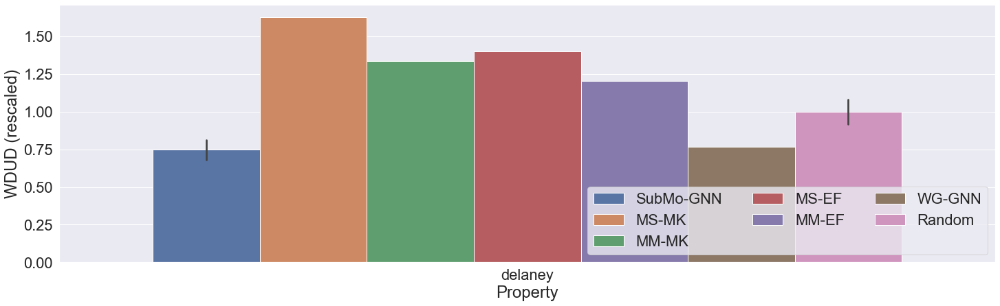

In [30]:
methods = ['logdet_ranking_normalize', 'maxsum_dissim_ranking_maccs', 'maxmin_dissim_ranking_maccs', 'maxsum_dissim_ranking_ecfp', 'maxmin_dissim_ranking_ecfp', 'wgreedy_ranking', 'random_ranking']
plotdf = wasserstein_distances[wasserstein_distances['method'].isin(methods)]

properties_lists = [
    ['measured log solubility in mols per litre'],
]

property_labels_lists = [
    ['delaney'],  
]

for i in range(1):
    properties = properties_lists[i]
    property_labels = property_labels_lists[i]
    plotdf_i = plotdf[plotdf['property'].isin(properties)]

    plt.clf()
    sns.set(font_scale=2)
    plt.figure(figsize=(20, 6))
    ax = sns.barplot(x="property", y="scaled_distance", hue='method',hue_order=methods, ci='sd', data=plotdf_i)
    ax.set(ylabel='WDUD (rescaled)', xlabel='Property')
    ax.set_xticklabels(property_labels)
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles=handles, labels=main_method_labels, loc = 'lower right', ncol=3)
    plt.tight_layout(pad=0,w_pad=0, h_pad=0)
    plt.savefig('./evaluation/weval_main_{}_delaney.png'.format(i+1))
#plt.show()

<Figure size 432x288 with 0 Axes>

<Figure size 1440x432 with 0 Axes>

<Figure size 1440x432 with 0 Axes>

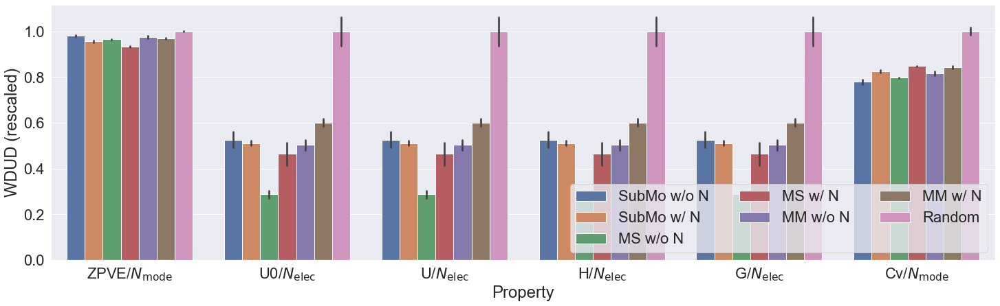

In [76]:
methods = ['logdet_ranking', 'logdet_ranking_normalize', 'maxsum_dissim_ranking', 'maxsum_dissim_ranking_normalize', 'maxmin_dissim_ranking', 'maxmin_dissim_ranking_normalize', 'random_ranking']
plotdf = wasserstein_distances[wasserstein_distances['method'].isin(methods)]

properties_lists = [
    ['mu', 'alpha', 'homo', 'lumo', 'gap', 'r2'],  
    ['zpve', 'u0', 'u298', 'h298', 'g298', 'cv'],  
    ['zpve/3n-6', 'u0/Nelec', 'u298/Nelec', 'h298/Nelec', 'g298/Nelec', 'cv/3n-6'],  
]

property_labels_lists = [
    ['mu', 'alpha', 'HOMO', 'LUMO', 'gap', 'R2'],  
    ['ZPVE', 'U0', 'U', 'H', 'G', 'Cv'],  
    [r'ZPVE/$N_{\rm mode}$', r'U0/$N_{\rm elec}$', r'U/$N_{\rm elec}$', r'H/$N_{\rm elec}$', r'G/$N_{\rm elec}$', r'Cv/$N_{\rm mode}$'],  
]

for i in range(3):
    properties = properties_lists[i]
    property_labels = property_labels_lists[i]
    plotdf_i = plotdf[plotdf['property'].isin(properties)]

    plt.clf()
    sns.set(font_scale=2)
    plt.figure(figsize=(20, 6))
    ax = sns.barplot(x="property", y="scaled_distance", hue='method',hue_order=methods, ci='sd', data=plotdf_i)
    ax.set(ylabel='WDUD (rescaled)', xlabel='Property')
    ax.set_xticklabels(property_labels)
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles=handles, labels=ablation_method_labels, loc = 'lower right', ncol=3)
    plt.tight_layout(pad=0,w_pad=0, h_pad=0)
    plt.savefig('./evaluation/weval_ablation_{}.png'.format(i+1))
#plt.show()

# Histgram

In [20]:
properties = ['measured log solubility in mols per litre']
properties_label = ['delaney']
methods = ['logdet_ranking_normalize', 'maxsum_dissim_ranking_maccs', 'random_ranking']
methods_label = ['SubMo-GNN', 'MS-MK', 'Random']

select_num = int(len(df['delaney']['_1'])*0.1)
max_dict = {}
min_dict = {}
for prop in properties:
    max_dict[prop] = df['delaney']['_1'][prop].max()
    min_dict[prop] = df['delaney']['_1'][prop].min()

/Users/nakamura.tomohiro/opt/anaconda3/envs/my-rdkit-env/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<Figure size 432x288 with 0 Axes>

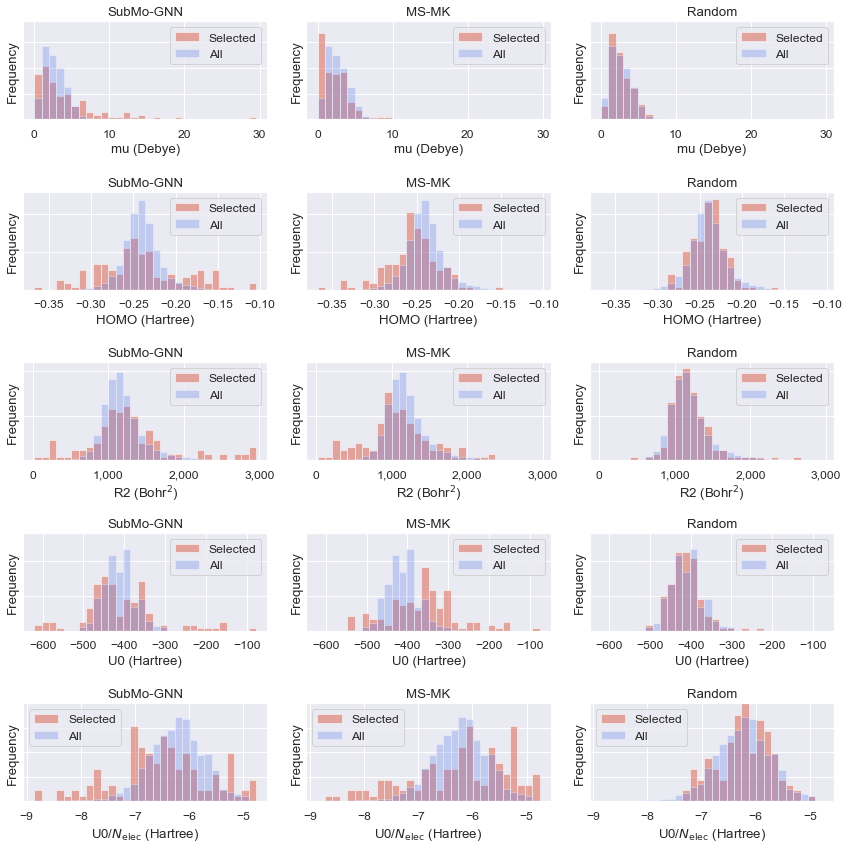

In [70]:
plt.clf()
sns.set(font_scale=1.1)
fig, axs = plt.subplots(len(properties), len(methods), figsize=(12, 12))

for i in range(len(methods)):
    if 'normalize' in methods[i]:
        selected = df['delaney_normalize']['_1'].sort_values(methods[i][:-10])[:select_num]
    else: 
        selected = df['qm9']['_1'].sort_values(methods[i])[:select_num]

    for j in range(len(properties)):
        sns.distplot(selected[properties[j]], bins=30, norm_hist=True, label='Selected', kde=False, ax=axs[j, i], 
                    hist_kws={"range": [min_dict[properties[j]], max_dict[properties[j]]], "alpha": 0.5, 
                              "color": sns.color_palette("coolwarm", 24)[21]}
                    )
        sns.distplot(df['qm9']['_1'][properties[j]], bins=30, norm_hist=True, label="All", kde=False, ax=axs[j, i], 
                    hist_kws={"range": [min_dict[properties[j]], max_dict[properties[j]]],  "alpha": 0.3, 
                              "color": sns.color_palette("coolwarm", 24)[2]} 
                    )

fig.subplots_adjust(hspace=0.4, wspace=0.2)
for i in range(len(methods)):
    for j in range(len(properties)):
        if properties[j] == 'r2':
            axs[j, i].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, loc: "{:,}".format(int(x))))
        axs[j,i].set_title(methods_label[i])
        # axs[j,i].set_xlabel(properties_label[j], fontsize=10)
        axs[j,i].set_xlabel(properties_label[j])
        # axs[j,i].set_ylabel('frequency', fontsize=10)
        axs[j,i].set_ylabel('Frequency')
        axs[j,i].tick_params(axis='y', which='both', left=False, right=False, labelleft=False)
        axs[j,i].legend()

for i in range(len(methods)):
    for j in range(len(properties)):
        if j == 0:
            axs[j,i].set_ylim(0,.38)
        elif j == 1:
            axs[j,i].set_ylim(0,26)
        elif j == 2:
            axs[j,i].set_ylim(0,.0022)
        elif j == 3:
            axs[j,i].set_ylim(0,.014)
        else:
            axs[j,i].set_ylim(0, 1)

#fig.show()
#plt.tight_layout(pad=0,w_pad=0, h_pad=0)
plt.tight_layout()
plt.savefig('evaluation/hist_qm9_perelec.pdf')

# Caluculate MPD

In [22]:
mpds = pd.DataFrame([])

gnn_based = ['logdet_ranking', 'maxsum_dissim_ranking', 'maxmin_dissim_ranking', 'random_ranking']
binary_based = ['maxsum_dissim_ranking_maccs', 'maxmin_dissim_ranking_maccs', 'maxsum_dissim_ranking_ecfp', 'maxmin_dissim_ranking_ecfp']
wasser_based = ['wgreedy_ranking']

mpds = pd.concat([mpds, dfs2mpd(df['delaney'], gnn_based, n_select)])

mpd = dfs2mpd(df['delaney_normalize'], gnn_based, n_select)
mpd['method'] = mpd['method'].apply(lambda x: x+'_normalize')
mpds = pd.concat([mpds, mpd])

mpds = pd.concat([mpds, dfs2mpd(df['delaney'], binary_based, n_select)])
mpds = pd.concat([mpds, dfs2mpd(df['delaney'], wasser_based, n_select)])

In [23]:
pickle.dump(mpds, open( "./evaluation/mpd_values_delaney.p", "wb" ))

df_mean = mpds.groupby(['method', 'fingerprint']).mean()
df_mean.to_csv("./evaluation/mpd_mean_delaney.csv")

df_std = mpds.groupby(['method', 'fingerprint']).std()
df_std.to_csv("./evaluation/mpd_std_delaney.csv")

# Barplot MPD

In [24]:
with open('./evaluation/mpd_values_delaney.p', 'rb') as f:
    mpds = pickle.load(f)

<Figure size 432x288 with 0 Axes>

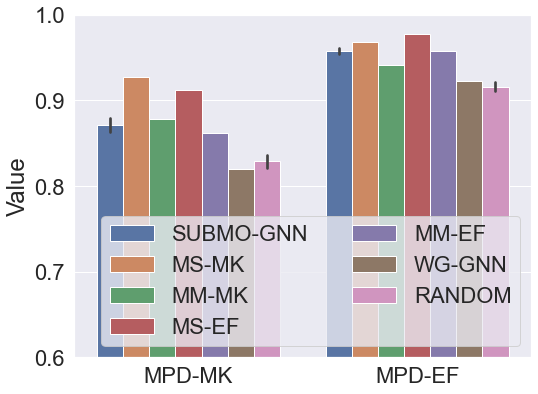

In [28]:
methods = ['logdet_ranking_normalize', 'maxsum_dissim_ranking_maccs', 'maxmin_dissim_ranking_maccs', 'maxsum_dissim_ranking_ecfp', 'maxmin_dissim_ranking_ecfp', 'wgreedy_ranking', 'random_ranking']
main_method_labels = ['SUBMO-GNN', 'MS-MK', 'MM-MK', 'MS-EF', 'MM-EF', 'WG-GNN', 'RANDOM']
plotdf = mpds[mpds['method'].isin(methods)]


plt.clf()
sns.set(font_scale=2)
plt.figure(figsize=(8, 6))
ax = sns.barplot(x="fingerprint", y="mpd", hue='method',hue_order=methods, ci='sd', data=plotdf)
ax.set(ylabel='Value', xlabel='')
ax.set_xticklabels(['MPD-MK', 'MPD-EF'])
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, labels=main_method_labels, loc = 'lower right', ncol=2)
plt.ylim([.6, 1])
#plt.tight_layout(pad=0,w_pad=0, h_pad=0)
plt.tight_layout()
plt.savefig('./evaluation/mpd_eval_delaney.png')
#plt.show()

start
logdet_ranking_normalize 5.9837804
logdet_ranking_normalize 5.9837804
logdet_ranking_normalize 5.9837804
logdet_ranking_normalize 5.9837804
logdet_ranking_normalize 5.9837804
logdet_ranking 5.899375
logdet_ranking 5.899375
logdet_ranking 5.899375
logdet_ranking 5.899375
logdet_ranking 5.899375
maxsum_dissim_ranking_normalize 6.8391333
maxsum_dissim_ranking_normalize 6.8391333
maxsum_dissim_ranking_normalize 6.8391333
maxsum_dissim_ranking_normalize 6.8391333
maxsum_dissim_ranking_normalize 6.8391333
maxsum_dissim_ranking 7.7332478
maxsum_dissim_ranking 7.7332478
maxsum_dissim_ranking 7.7332478
maxsum_dissim_ranking 7.7332478
maxsum_dissim_ranking 7.7332478


/Users/nakamura.tomohiro/opt/anaconda3/envs/my-rdkit-env/lib/python3.7/site-packages/ipykernel_launcher.py:79: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


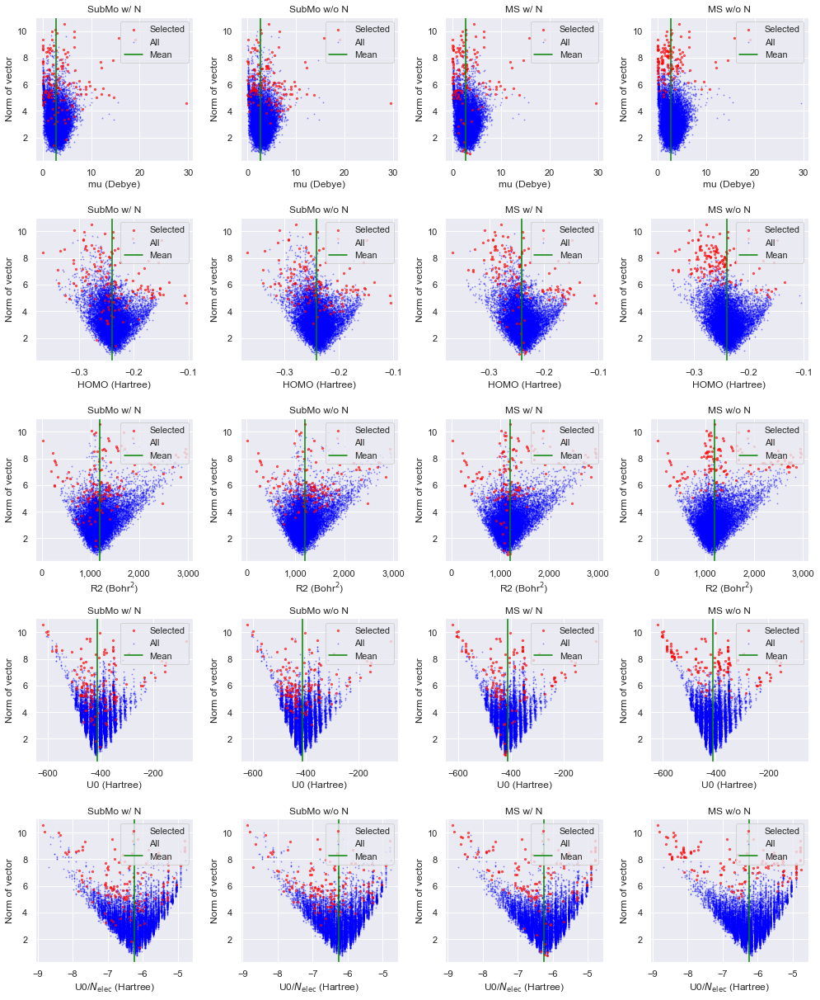

In [18]:
import matplotlib.pyplot as plt
sns.set()
# MS without Normalizeも入れる

# random seed
import random
import numpy as np
random.seed(1)
np.random.seed(1)

df['qm9_normalize']['_1']['not normalized embedding'] = df['qm9']['_1']['embedding']

# properties = ['mu', 'alpha', 'homo', 'lumo', 'gap', 'r2', 'zpve', 'u0', 'u298', 'h298', 'g298', 'cv']
# methods = ['logdet_ranking', 'logdet_ranking_normalize', 'maxsum_dissim_ranking', 
#            'maxsum_dissim_ranking_normalize', 'maxmin_dissim_ranking', 
#            'maxmin_dissim_ranking_normalize', 'random_ranking']
methods = ['logdet_ranking_normalize', 'logdet_ranking', 'maxsum_dissim_ranking_normalize', 'maxsum_dissim_ranking']
properties = ['mu', 'homo', 'r2', 'u0', 'u0/Nelec']

properties_label = ['mu (Debye)', 'HOMO (Hartree)',r'R2 (Bohr${}^2$)', 'U0 (Hartree)', r'U0/$N_{\rm elec}$ (Hartree)']
# methods_label = ['logdet w/o normalize', 'logdet', 'maxsum w/o normalize', 
#            'maxsum', 'maxmin w/o normalize', 
#            'maxmin', 'random']
methods_label = ['SubMo w/ N', 'SubMo w/o N', 'MS w/ N', 'MS w/o N']
print('start')

fig, axs = plt.subplots(len(properties), len(methods), figsize=(14, 17))
select_num = int(len(df['qm9']['_1'])*0.01)

for i in range(len(methods)):
    if 'normalize' in methods[i]:
        df_sort = df['qm9_normalize']['_1'].sort_values(methods[i][:-10])
        for j in range(len(properties)):
            embedding = df_sort['not normalized embedding'].to_numpy()
            embedding_norm = [np.linalg.norm(em) for em in embedding]
            real_values = df_sort[properties[j]].to_numpy()
            axs[j,i].scatter(real_values[select_num:], embedding_norm[select_num:], alpha=0.3, color='blue', label='All', s=1)
            axs[j,i].scatter(real_values[:select_num], embedding_norm[:select_num], alpha=0.6, color='red', label='Selected', s=5)
            axs[j,i].axvline(x=np.mean(real_values), alpha=1, color='green', label='Mean')
            print(methods[i], np.median(embedding_norm[:select_num]))
    else:
        df_sort = df['qm9']['_1'].sort_values(methods[i])
        for j in range(len(properties)):
            embedding = df_sort.embedding.to_numpy()
            embedding_norm = [np.linalg.norm(em) for em in embedding]
            real_values = df_sort[properties[j]].to_numpy()
            axs[j,i].scatter(real_values[select_num:], embedding_norm[select_num:], alpha=0.3, color='blue', label='All', s=1)
            axs[j,i].scatter(real_values[:select_num], embedding_norm[:select_num], alpha=0.6, color='red', label='Selected', s=5)
            axs[j,i].axvline(x=np.mean(real_values), alpha=1, color='green', label='Mean')
            print(methods[i], np.median(embedding_norm[:select_num]))


fig.subplots_adjust(hspace=0.4, wspace=0.3)

for i in range(len(methods)):
    for j in range(len(properties)):
        axs[j,i].set_title(methods_label[i])
        # axs[j,i].set_xlabel(properties_label[j], fontsize=10)
        axs[j,i].set_xlabel(properties_label[j])
        # axs[j,i].set_ylabel('frequency', fontsize=10)
        axs[j,i].set_ylabel('Norm of vector')
        # axs[j,i].tick_params(axis='y', which='both', left=False, right=False, labelleft=False)
        hans, labs = axs[j, i].get_legend_handles_labels()
        axs[j,i].legend(handles=hans[::-1], labels=labs[::-1], loc=1)
        if j == 2:
            axs[j, i].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, loc: "{:,}".format(int(x))))
        
# for i in range(len(methods)):
#     for j in range(len(properties)):
#         if j == 0:
#             axs[j,i].set_ylim(0,0.8)
#         if j == 1:
#             axs[j,i].set_ylim(0,35)
#         if j == 2:
#             axs[j,i].set_ylim(0,0.0035)
#         if j == 3:
#             axs[j,i].set_ylim(0,0.040)
        
fig.show()
fig.tight_layout()
plt.savefig('evaluation/norm_qm9_relu.png')